<a href="https://colab.research.google.com/github/bsaheed/GenModelling/blob/main/Attention_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
import tensorflow as tf
import pandas as pd
import numpy as np
from keras.layers import Dense
from sklearn.model_selection import train_test_split
from keras.optimizers import Adam
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
from keras.models import Model
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    accuracy_score, confusion_matrix, ConfusionMatrixDisplay,
    RocCurveDisplay, auc, precision_score, recall_score,
    f1_score, roc_curve, classification_report, roc_auc_score
)
from sklearn.preprocessing import LabelEncoder
from keras.layers import Input, Conv1D, Dense,BatchNormalization,Dropout, MaxPooling1D
from imblearn.over_sampling import SMOTE
import pickle


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
data_dir = '/content/drive/MyDrive/COMPUTER VISION/Noise Analysis/SECURITY/preprocessed_data_for_ids2017.csv'

In [8]:
df = pd.read_csv(data_dir)
df.head()

,Unnamed: 0,Destination Port,Flow Duration,Total Fwd Packets,Total Backward Packets,Total Length of Fwd Packets,Total Length of Bwd Packets,Fwd Packet Length Max,Fwd Packet Length Min,Fwd Packet Length Mean,...,min_seg_size_forward,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Attack Type
0,0,80,5665,2,0,12,0,6,6,6.0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
1,1,53,49079,2,2,72,168,36,36,36.0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2,2,53,184,2,2,106,202,53,53,53.0,...,32,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
3,3,53,174,2,2,168,264,84,84,84.0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
4,4,443,305308,2,0,0,0,0,0,0.0,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN


In [9]:
df.drop('Unnamed: 0', axis = 1, inplace = True)

In [10]:
df['Attack Type'].value_counts()

,count
Attack Type,
BENIGN,10000
DoS,10000
DDoS,10000
Port Scan,10000
Brute Force,9152
Web Attack,2143
Bot,1953


In [11]:
X= df.drop(['Attack Type' ], axis = 1)
y = df['Attack Type']

In [12]:
from sklearn.impute import SimpleImputer


# Impute missing values using the mean strategy
imputer = SimpleImputer(strategy='mean') # You can use other strategies like 'median' or 'most_frequent'

# Fit and transform the imputer on your feature data
X_imputed = imputer.fit_transform(X)

In [13]:
from imblearn.over_sampling import SMOTE

# Now apply SMOTE to the imputed data
smote = SMOTE(sampling_strategy='auto', random_state=0)
X_upsampled, y_upsampled = smote.fit_resample(X_imputed, y)

blnc_data = pd.DataFrame(X_upsampled, columns=X.columns)  # Use original column names
blnc_data['Attack Type'] = y_upsampled
blnc_data = blnc_data.sample(frac=1)

blnc_data['Attack Type'].value_counts()

,count
Attack Type,
BENIGN,10000
Port Scan,10000
DoS,10000
Web Attack,10000
DDoS,10000
Brute Force,10000
Bot,10000


In [14]:
X = blnc_data.drop('Attack Type', axis=1)
y = blnc_data['Attack Type']

In [15]:
features = list(X.columns)

In [16]:
le = LabelEncoder()
y = le.fit_transform(y)

In [17]:


# Printing corresponding attack type for each encoded value
print('......\n')
labels = le.classes_

......



In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)


In [19]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)


(56000, 70) (56000,)
(14000, 70) (14000,)


In [20]:
y_train = tf.keras.utils.to_categorical(y_train)
y_test = tf.keras.utils.to_categorical(y_test)

print(y_train.shape)
print(y_test.shape)

(56000, 7)
(14000, 7)


# MODEL DEVELOPMENT

In [44]:
checkpoints = tf.keras.callbacks.ModelCheckpoint('best_model.keras', monitor='val_accuracy', save_best_only=True, mode='max')
es = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)

In [45]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam



class ChannelAttention1D(layers.Layer):
    def __init__(self, filters, reduction_ratio=8):
        super(ChannelAttention1D, self).__init__()
        self.filters = filters
        self.reduction_ratio = reduction_ratio

    def build(self, input_shape):
        self.shared_dense_one = layers.Dense(self.filters // self.reduction_ratio, activation='relu')
        self.shared_dense_two = layers.Dense(self.filters)

    def call(self, inputs):
        avg_pool = tf.reduce_mean(inputs, axis=1, keepdims=True)  # Global average pooling
        max_pool = tf.reduce_max(inputs, axis=1, keepdims=True)  # Global max pooling

        avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
        max_out = self.shared_dense_two(self.shared_dense_one(max_pool))

        out = tf.sigmoid(avg_out + max_out)
        return inputs * out  # Scale the input by the attention map
class SpatialAttention1D(layers.Layer):
    def __init__(self, kernel_size=3):
        super(SpatialAttention1D, self).__init__()
        self.conv = layers.Conv1D(1, kernel_size, padding='same', activation='sigmoid')

    def call(self, inputs):
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)
        concat = tf.concat([avg_pool, max_pool], axis=-1)
        attention_map = self.conv(concat)
        return inputs * attention_map  # Scale the input by the spatial attention map
class CBAM1D(layers.Layer):
    def __init__(self, filters, reduction_ratio=8, kernel_size=3):
        super(CBAM1D, self).__init__()
        self.channel_attention = ChannelAttention1D(filters, reduction_ratio)
        self.spatial_attention = SpatialAttention1D(kernel_size)

    def call(self, inputs):
        x = self.channel_attention(inputs)
        x = self.spatial_attention(x)
        return x

def create_cbam_1d_cnn_model(input_shape):
    inputs = layers.Input(shape=input_shape)

    # 1D CNN Layers with CBAM
    x = layers.Conv1D(32, 3, activation='relu', padding ='same')(inputs)
    x = CBAM1D(32)(x)
    x = layers.MaxPooling1D(2)(x)
    x = layers.Conv1D(64, 3, activation='relu',padding ='same')(x)
    x = CBAM1D(64)(x)
    x = layers.MaxPooling1D(2)(x)
    x = layers.Dropout(0.2)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Flatten()(x)
    x = layers.Dense(64, activation='relu')(x)
    x = layers.Dropout(0.3)(x)
    x= layers.Dense(32, activation='relu')(x)
    outputs = layers.Dense(7, activation='softmax')(x)
    model = models.Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    return model


In [46]:
model = create_cbam_1d_cnn_model(input_shape=(X_train.shape[1], 1))
model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 70, 1)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_16 (Conv1D)                   │ (None, 70, 32)              │             128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ cbam1d_8 (CBAM1D)                    │ (None, 70, 32)              │             299 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_8 (MaxPooling1D)       │ (None, 35, 32)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_18 (Conv1D)                   │ (None, 35, 64)              │           6,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ cbam1d_9 (CBAM1D)                    │ (None, 35, 64)              │           1,103 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_9 (MaxPooling1D)       │ (None, 17, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_8 (Dropout)                  │ (None, 17, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 17, 64)              │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 1088)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_32 (Dense)                     │ (None, 64)                  │          69,696 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_33 (Dense)                     │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_34 (Dense)                     │ (None, 7)                   │             231 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 80,001 (312.50 KB)

 Trainable params: 79,873 (312.00 KB)

 Non-trainable params: 128 (512.00 B)

In [47]:
history = model.fit(X_train, y_train, epochs=30, batch_size=64, validation_split=0.2, callbacks =[checkpoints,es])

Epoch 1/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - accuracy: 0.7857 - loss: 0.6430 - val_accuracy: 0.9163 - val_loss: 0.2408
Epoch 2/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - accuracy: 0.9065 - loss: 0.2689 - val_accuracy: 0.9282 - val_loss: 0.1848
Epoch 3/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.9226 - loss: 0.2166 - val_accuracy: 0.9449 - val_loss: 0.1564
Epoch 4/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - accuracy: 0.9409 - loss: 0.1741 - val_accuracy: 0.9558 - val_loss: 0.1322
Epoch 5/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9500 - loss: 0.1524 - val_accuracy: 0.9624 - val_loss: 0.1114
Epoch 6/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - accuracy: 0.9538 - loss: 0.1415 - val_accuracy: 0.9626 - val_loss: 0.1139
Epoch 7/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9591 - loss: 0.1280 - val_accuracy: 0.9639 - val_loss: 0.1134
Epoch 8/30
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9585 - loss: 0.1254 - val_accuracy: 0

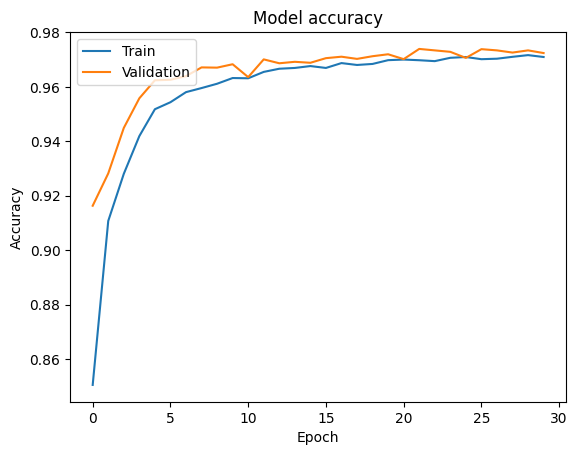

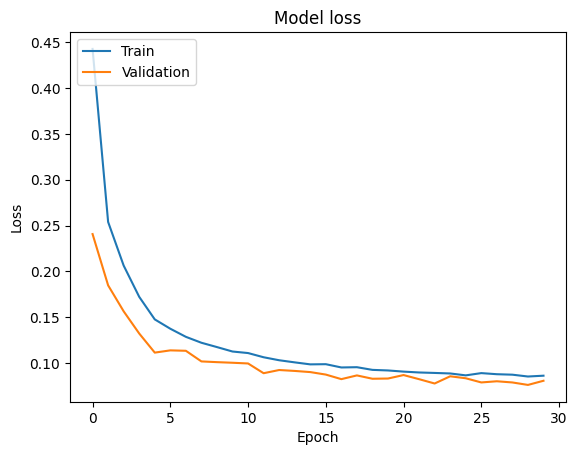

In [48]:
# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [49]:
# Evaluate the model

evaluation = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {evaluation[1]}")

438/438 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.9748 - loss: 0.0779
Test Accuracy: 0.9752143025398254


In [50]:
y_pred = model.predict(X_test)

438/438 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


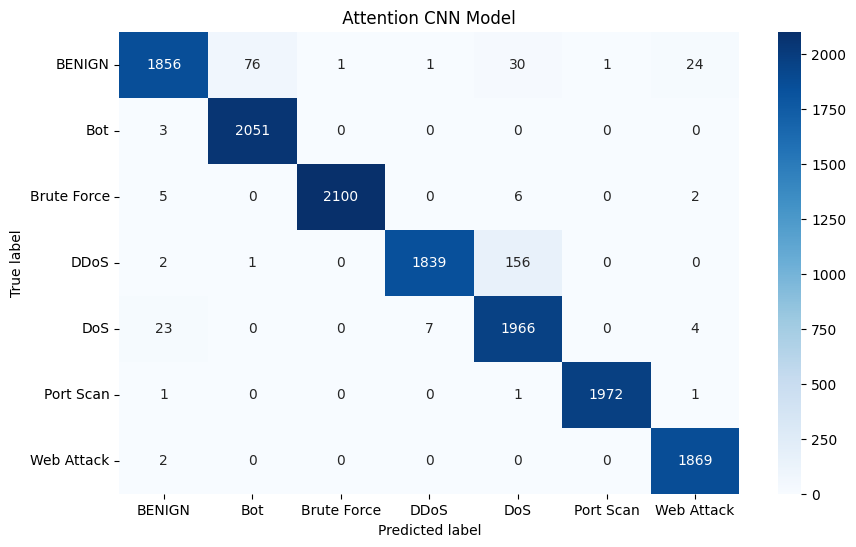

In [51]:
# Convert the predicted probabilities to class labels
y_pred_classes = np.argmax(y_pred, axis=1)

# Now use y_pred_classes in the confusion_matrix function
conf_matrix_model1 = confusion_matrix(np.argmax(y_test, axis=1), y_pred_classes)

plt.figure(figsize =(10,6))
sns.heatmap(conf_matrix_model1, annot = True, fmt ='d', cmap = 'Blues', xticklabels = labels, yticklabels = labels)
plt.title(' Attention CNN Model ')

plt.xlabel('Predicted label')
plt.ylabel('True label')

plt.show()

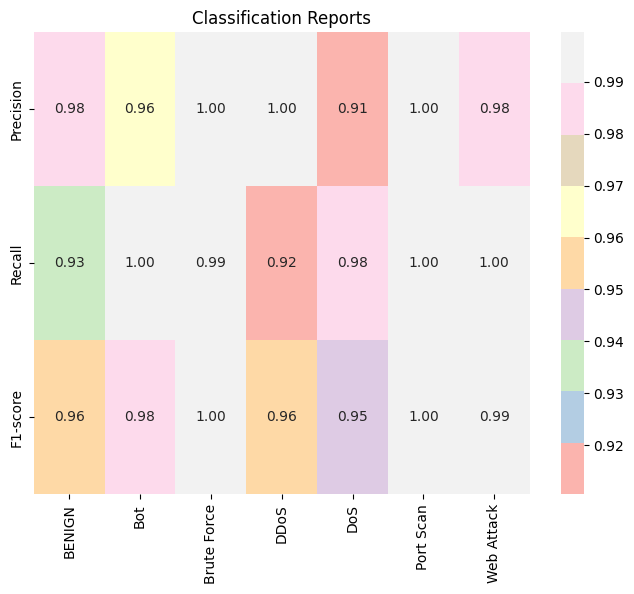

In [52]:
y_test_classes = np.argmax(y_test, axis=1)
metrics1 = classification_report(y_true = y_test_classes, y_pred = y_pred_classes, target_names = labels, output_dict = True)
precision1 = [metrics1[target_name]['precision'] for target_name in labels]
recall1 = [metrics1[target_name]['recall'] for target_name in labels]
f1_score1 = [metrics1[target_name]['f1-score'] for target_name in labels]
data1 = np.array([precision1, recall1, f1_score1])
rows = ['Precision', 'Recall', 'F1-score']
plt.figure(figsize= (8,6))

sns.heatmap(data1, cmap = 'Pastel1', annot = True, fmt = '.2f', xticklabels = labels, yticklabels = rows)
plt.title('Classification Reports')
plt.show()

In [53]:
print(f' Accuracy score, {accuracy_score(y_pred_classes, y_test_classes)}')

 Accuracy score, 0.9752142857142857


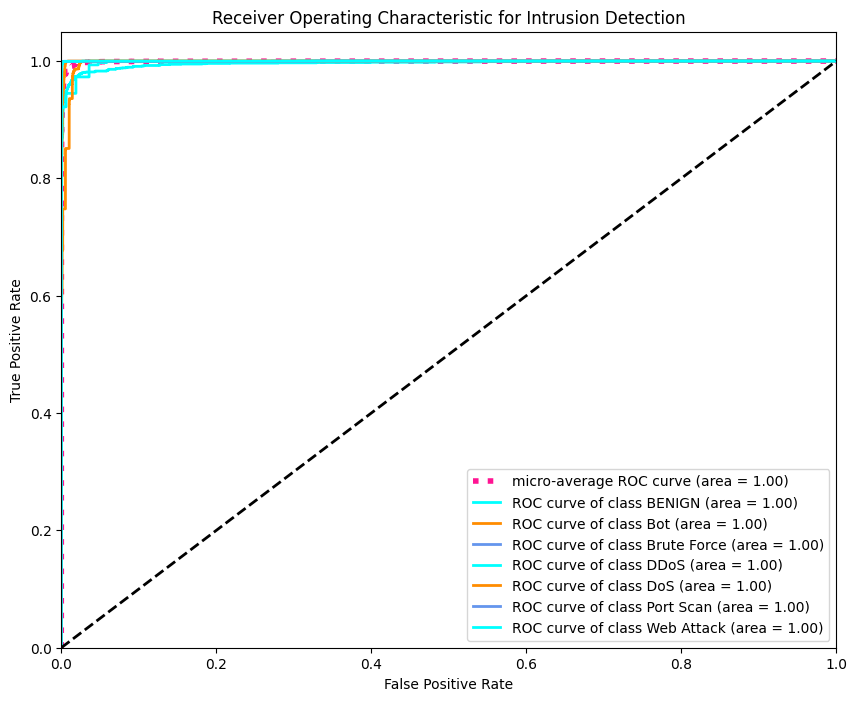

In [54]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle

num_classes = len(labels)
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot ROC curves
plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])
for i, color in zip(range(num_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(labels[i], roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic for Intrusion Detection')
plt.legend(loc="lower right")
plt.show()


In [ ]:
# model.save('/content/drive/MyDrive/COMPUTER VISION/Noise Analysis/SECURITY/cbam_1d_cnn_model.keras')

# **XAI**

In [ ]:
import shap
import tensorflow as tf

class AttentionModelWrapper:
    def __init__(self, model):
        self.model = model

    def predict(self, data):
        # Model prediction
        predictions = self.model(data)
        return predictions.numpy()

# Wrap your model
wrapped_model = AttentionModelWrapper(model)


In [ ]:
new_test = X_test.values.reshape(X_test.shape[0], X_test.shape[1], 1)

In [ ]:
new_train = X_train.values.reshape(X_train.shape[0], X_train.shape[1], 1)

In [ ]:
new_test.shape

(14000, 70, 1)

In [ ]:
explainer = shap.GradientExplainer(wrapped_model.model, data=new_train[:1000])
shap_values = explainer.shap_values(new_test)




In [ ]:
print('shap values shape',shap_values.shape)
print('data shape,', new_test.shape)

shap values shape (14000, 70, 1, 7)
data shape, (14000, 70, 1)


In [ ]:
# Assuming shap_values has shape (14000, 71, 1, 7)
shap_values_reshaped = shap_values.squeeze(axis=2)  # Remove the last dimension, now shape: (14000, 71, 7)


In [ ]:
shap_values_reshaped.shape

(14000, 70, 7)

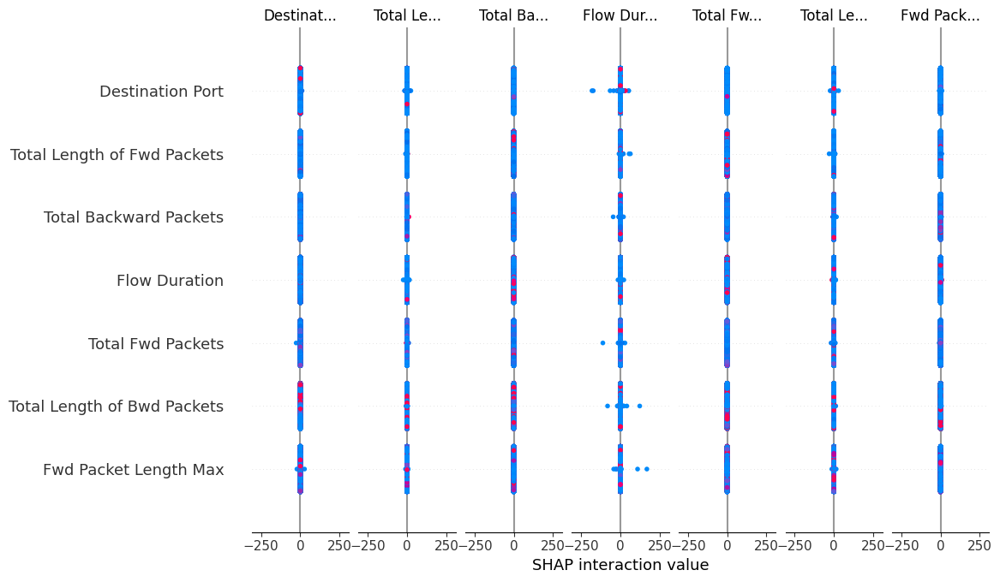

In [ ]:
# Visualize the explanation
shap.summary_plot(shap_values_reshaped, X_test)

<ipython-input-39-d002d3d5dd4e>:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap("plasma")  # Try 'plasma', 'coolwarm', etc.


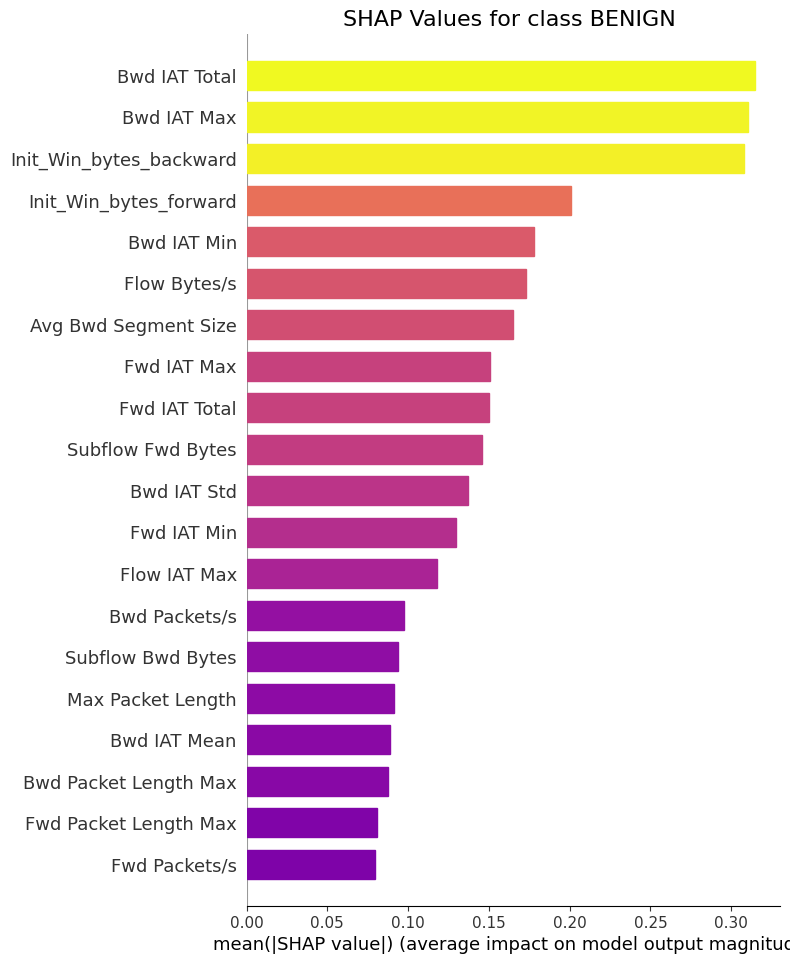

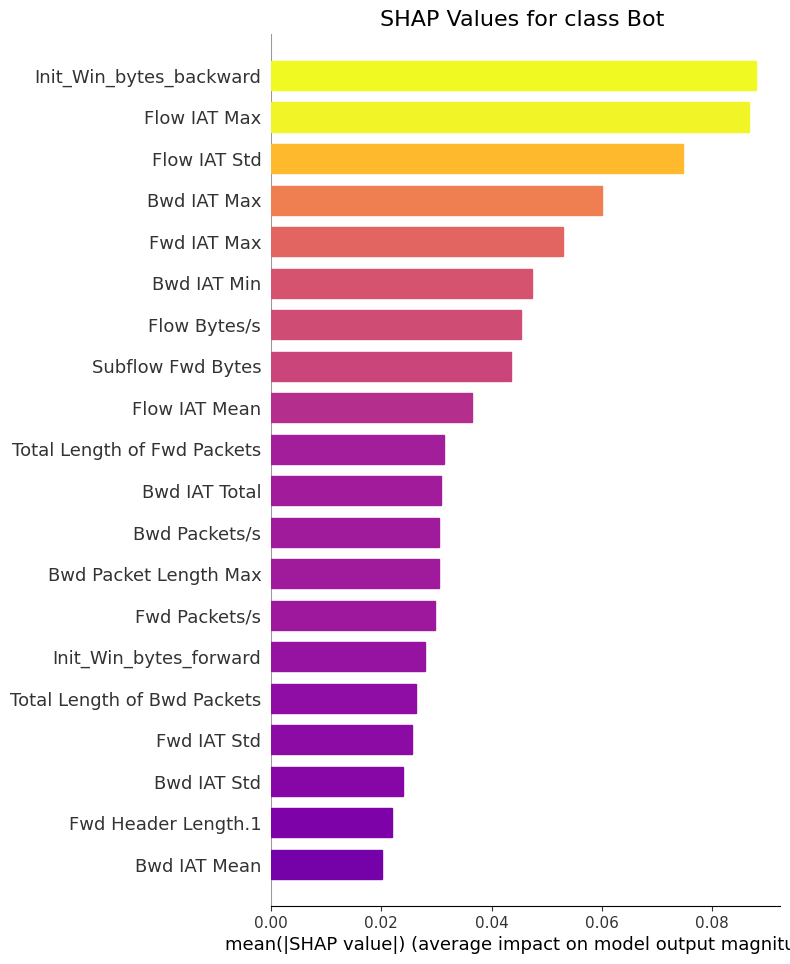

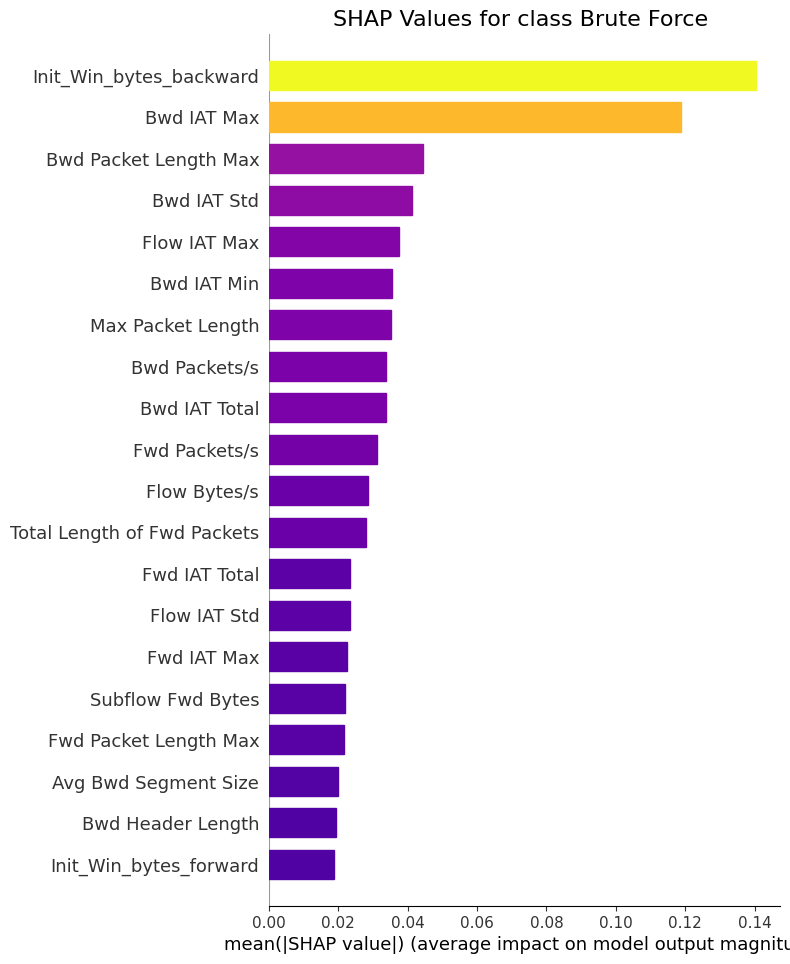

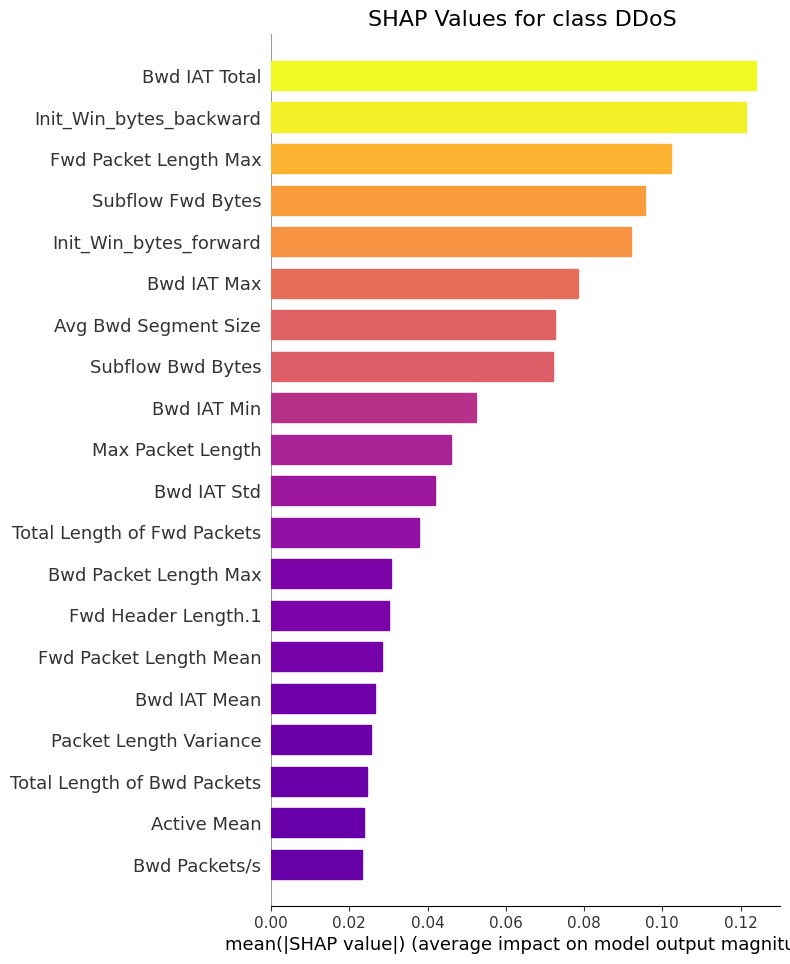

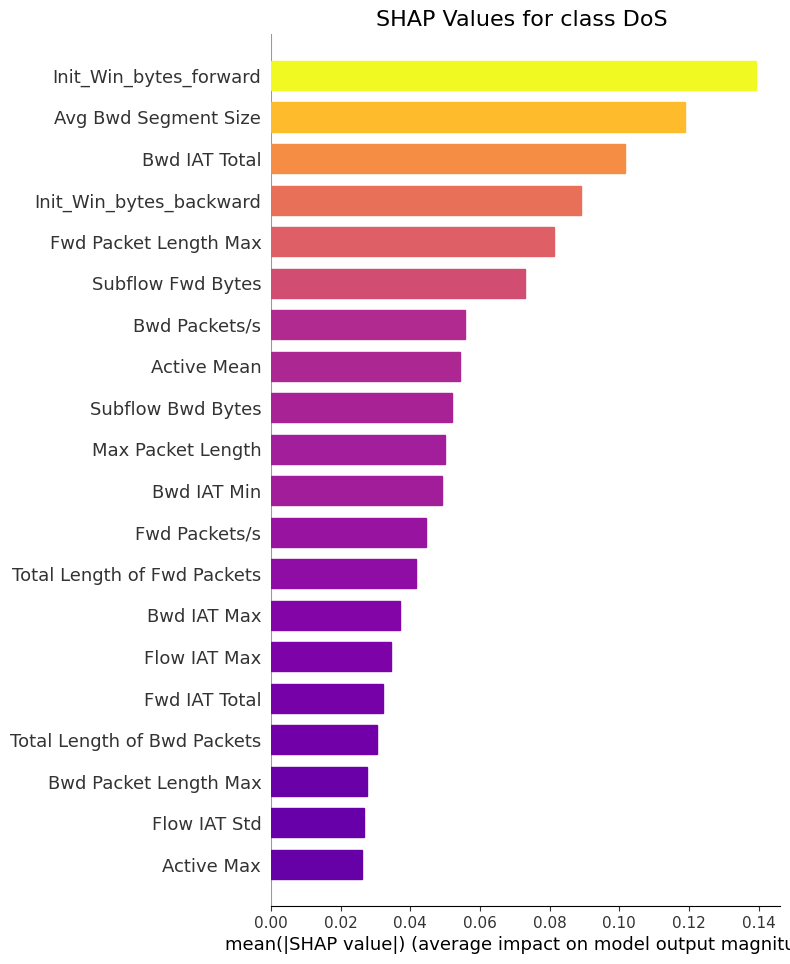

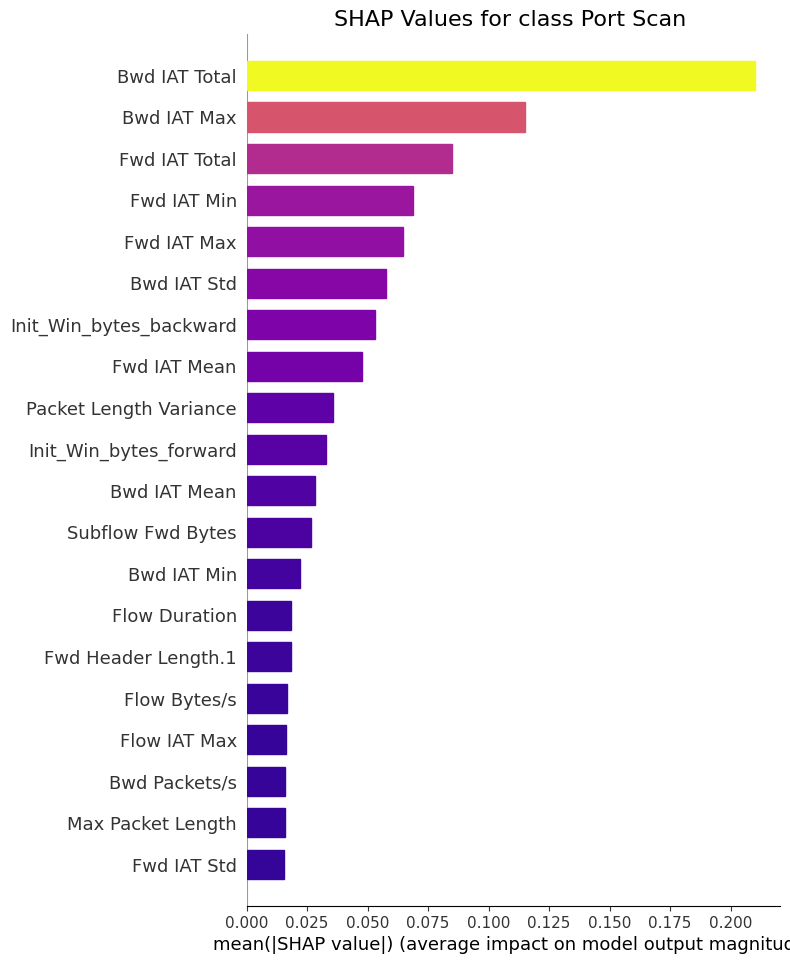

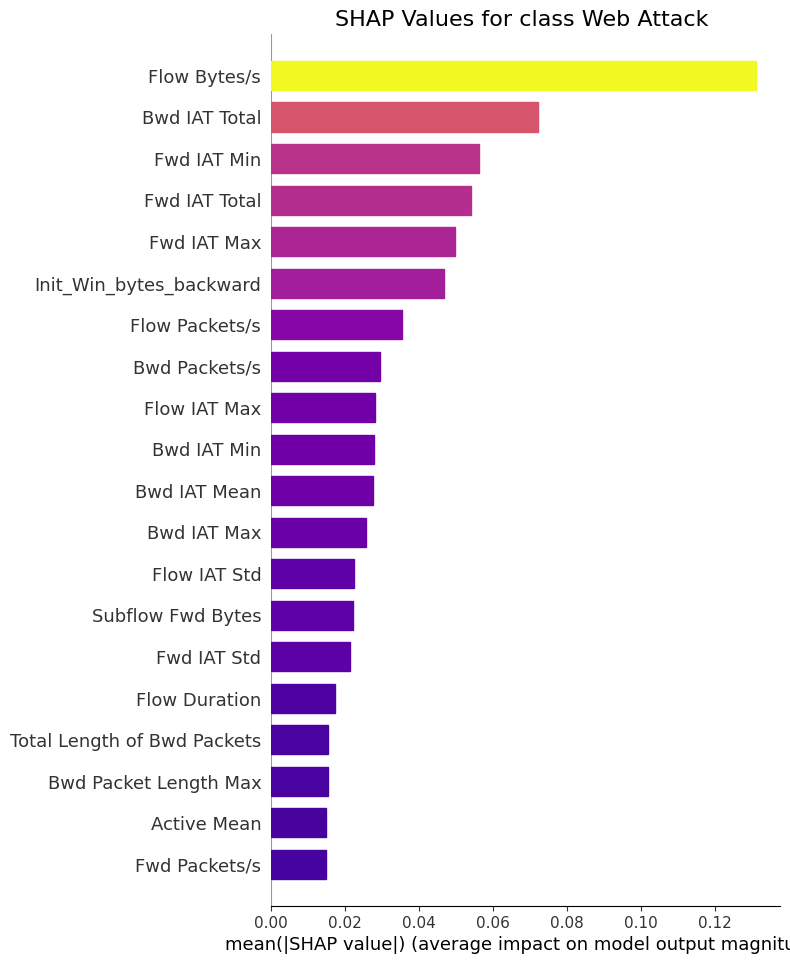

In [ ]:
import matplotlib.cm as cm

# Choose a colormap
cmap = cm.get_cmap("plasma")  # Try 'plasma', 'coolwarm', etc.
for i in range(7):
    # Generate the summary plot
    plt.figure(figsize=(10, 6))
    shap.summary_plot(
        shap_values_reshaped[:, :, i], X_test, plot_type="bar", show=False  # Generate without showing
    )

    # Apply a gradient based on feature importance
    bars = plt.gca().patches
    importance_values = [bar.get_width() for bar in bars]
    colors = cmap(importance_values / max(importance_values))  # Normalize to colormap range

    for bar, color in zip(bars, colors):
        bar.set_color(color)

    plt.title(f"SHAP Values for class {labels[i]} ", fontsize=16)
    plt.show()

#LIME

In [ ]:
!pip install lime
import lime
import lime.lime_tabular

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=5b47fae5b5d05d8b036c9797630c03dbe6b47ba9d5fd9bf16f24ef614278a17d
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
import warnings
warnings.filterwarnings("ignore")


In [ ]:
import lime
import lime.lime_tabular
import numpy as np  # Import numpy

###############################################
# LIME (Local Interpretable Model-agnostic Explanations) for Multiclass
###############################################
# Create LIME explainer
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    class_names=labels,  # Adapt to your class names (0 to 9)
    mode='classification'
)

def predict_fn(inputs):
    # Reshape to match your model's expected input shape explicitly
    # Assuming your model expects input shape (batch_size, num_features)
    inputs = inputs.reshape(-1, X_train.shape[1])
    return model.predict(inputs)

# Explain a single instance
for i in range(10, 1000, 100):
    # Index of the instance to explain
    exp = explainer_lime.explain_instance(
        data_row=X_test.iloc[i],
        predict_fn=predict_fn,
        num_features=10
    )
    exp.show_in_notebook(show_table=True)

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


# EVALUATING XAI

In [ ]:
import shap

# Assuming `model` is the trained DNN model and `X_train` is the training data
# explainer = shap.Explainer(model, X_train)
# shap_values = explainer(X_train)
explainer = shap.GradientExplainer(wrapped_model.model, data=new_train)
shap_values = explainer.shap_values(new_train)
# Calculate mean absolute SHAP value for each feature
feature_importance = np.abs(shap_values.values).mean(axis=0)
feature_ranking = np.argsort(feature_importance)[::-1]  # Indices of features in descending order



In [ ]:
k_values = [0, 5, 10, 25, 50, 70]
accuracies = []

for k in k_values:
    selected_features = feature_ranking[k:]  # Retain features excluding top-k
    X_train_k = new_train[:, selected_features]
    X_test_k = new_test[:, selected_features]

    # Re-train the model
    model_k = create_cbam_1d_cnn_model(input_shape=X_train_k.shape[1:])
    model_k.fit(X_train_k, y_train, epochs=10, batch_size=32, verbose=0)

    # Evaluate the model
    _, accuracy = model_k.evaluate(X_test_k, y_test, verbose=0)
    accuracies.append(accuracy)


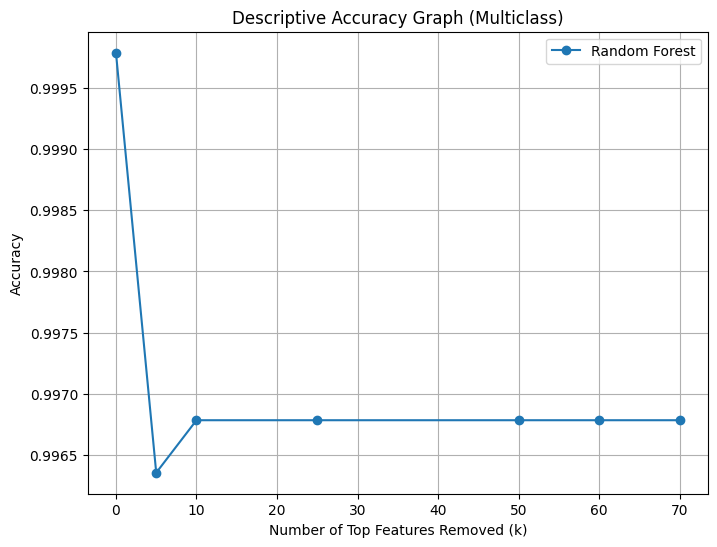

In [ ]:
k_values = [0, 5, 10, 25, 50,60,70]
# k_values = [0,8]
accuracies = []

for k in k_values:
    # Remove top-k features
    k_features = X_train.columns[sorted_features[:k]]
    X_train_reduced = X_train.drop(columns=k_features)
    X_test_reduced = X_test.drop(columns=k_features)
    # X_train_reduced = X_train[:, reduced_features]
    # X_test_reduced = X_test[:, reduced_features]

    # Train model on reduced dataset
    model.fit(X_train_reduced, y_train)
    y_pred = model.predict(X_test_reduced)

    # Record accuracy
    accuracies.append(accuracy_score(y_test, y_pred))

# Plot the accuracy graph
plt.figure(figsize=(8, 6))
plt.plot(k_values, accuracies, marker='o', label="Random Forest")
plt.xlabel("Number of Top Features Removed (k)")
plt.ylabel("Accuracy")
plt.title("Descriptive Accuracy Graph (Multiclass)")
plt.legend()
plt.grid()
plt.show()

In [ ]:
from sklearn.tree import DecisionTreeClassifier

dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train, y_train)
# Compute SHAP Feature Importance
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)  # SHAP values for Decision Tree
feature_importance = np.mean([np.abs(s).mean(axis=0) for s in shap_values], axis=0)  # Multiclass
sorted_features = np.argsort(feature_importance)[::-1]  # Rank features by importance


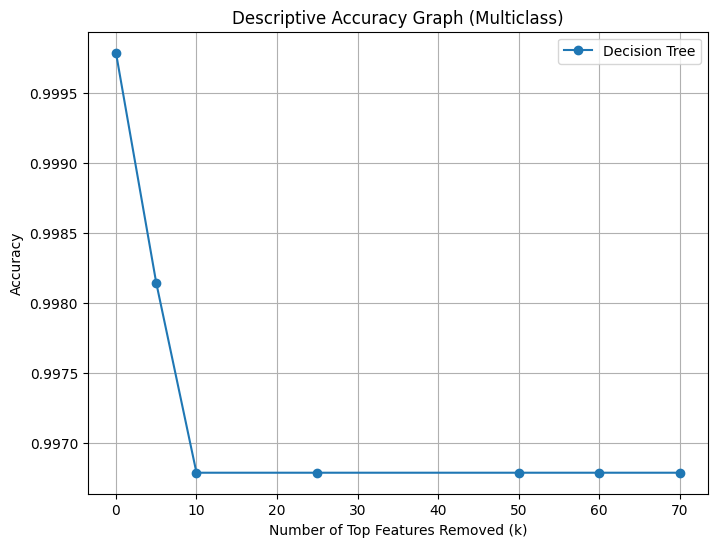

In [ ]:
k_values = [0, 5, 10, 25, 50,60,70]
# k_values = [0,8]
accuracies = []

for k in k_values:
    # Remove top-k features
    k_features = X_train.columns[sorted_features[:k]]
    X_train_reduced = X_train.drop(columns=k_features)
    X_test_reduced = X_test.drop(columns=k_features)
    # X_train_reduced = X_train[:, reduced_features]
    # X_test_reduced = X_test[:, reduced_features]

    # Train model on reduced dataset
    model.fit(X_train_reduced, y_train)
    y_pred = model.predict(X_test_reduced)

    # Record accuracy
    accuracies.append(accuracy_score(y_test, y_pred))

# Plot the accuracy graph
plt.figure(figsize=(8, 6))
plt.plot(k_values, accuracies, marker='o', label="Decision Tree")
plt.xlabel("Number of Top Features Removed (k)")
plt.ylabel("Accuracy")
plt.title("Descriptive Accuracy Graph (Multiclass)")
plt.legend()
plt.grid()
plt.show()

CALLABLE model


In [ ]:
class ChannelAttention1D(layers.Layer):
    def __init__(self, filters, reduction_ratio=8):
        super(ChannelAttention1D, self).__init__()
        self.filters = filters
        self.reduction_ratio = reduction_ratio

    def build(self, input_shape):
        self.shared_dense_one = layers.Dense(self.filters // self.reduction_ratio, activation='relu')
        self.shared_dense_two = layers.Dense(self.filters)

    def call(self, inputs, return_attention=False):
        avg_pool = tf.reduce_mean(inputs, axis=1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=1, keepdims=True)

        avg_out = self.shared_dense_two(self.shared_dense_one(avg_pool))
        max_out = self.shared_dense_two(self.shared_dense_one(max_pool))

        attention_map = tf.sigmoid(avg_out + max_out)
        if return_attention:
            return attention_map  # Return only the attention map
        return inputs * attention_map

class SpatialAttention1D(layers.Layer):
    def __init__(self, kernel_size=3):
        super(SpatialAttention1D, self).__init__()
        self.conv = layers.Conv1D(1, kernel_size, padding='same', activation='sigmoid')

    def call(self, inputs, return_attention=False):
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)
        concat = tf.concat([avg_pool, max_pool], axis=-1)
        attention_map = self.conv(concat)
        if return_attention:
            return attention_map  # Return only the attention map
        return inputs * attention_map

class CBAM1D(layers.Layer):
    def __init__(self, filters, reduction_ratio=8, kernel_size=3):
        super(CBAM1D, self).__init__()
        self.channel_attention = ChannelAttention1D(filters, reduction_ratio)
        self.spatial_attention = SpatialAttention1D(kernel_size)

    def call(self, inputs, return_attention=False):
        if return_attention:
            channel_attention_map = self.channel_attention(inputs, return_attention=True)
            spatial_attention_map = self.spatial_attention(inputs, return_attention=True)
            return channel_attention_map, spatial_attention_map
        x = self.channel_attention(inputs)
        x = self.spatial_attention(x)
        return x
def create_cbam_1d_cnn_model(input_shape):
  inputs = layers.Input(shape=input_shape)

  # 1D CNN Layers with CBAM
  x = layers.Conv1D(32, 3, activation='relu', padding ='same')(inputs)
  # x = layers.Conv1D(32, 3, activation='relu', padding ='same')(x)
  # x = layers.BatchNormalization()(x)
  x = CBAM1D(32)(x)
  x = layers.MaxPooling1D(2)(x)
  x = layers.Dropout(0.2)(x)
  x = layers.BatchNormalization()(x)

  x = layers.Conv1D(64, 3, activation='relu',padding ='same')(x)
  # x = layers.Conv1D(64, 3, activation='relu',padding ='same')(x)
  # x = layers.BatchNormalization()(x)
  x = CBAM1D(64)(x)
  x = layers.MaxPooling1D(2)(x)
  x = layers.Dropout(0.2)(x)
  x = layers.BatchNormalization()(x)

  # x = layers.Conv1D(128, 3, activation='relu', padding ='same')(x)
  # x = layers.Conv1D(128, 3, activation='relu', padding ='same')(x)

  # x = CBAM1D(128)(x)
  # x = layers.MaxPooling1D(2)(x)
  # x = layers.Dropout(0.2)(x)
  # x = layers.BatchNormalization()(x)
      # Flatten and Fully Connected Layers
  x = layers.Flatten()(x)
  # x = layers.Dense(256, activation='relu')(x)
  # x = layers.Dropout(0.2)(x)

  x = layers.Dense(64, activation='relu')(x)
  x = layers.Dropout(0.3)(x)
  x= layers.Dense(32, activation='relu')(x)
  # x = layers.Dropout(0.3)(x)

  # Output Layer (multi classification for IDS)
  outputs = layers.Dense(7, activation='softmax')(x)


  model = models.Model(inputs=inputs, outputs=outputs)
  model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
  return model


In [ ]:
model1 = create_cbam_1d_cnn_model(input_shape=(X_train.shape[1], 1))
model1.summary()

Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)          │ (None, 71, 1)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_34 (Conv1D)                   │ (None, 71, 32)              │             128 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ cbam1d_10 (CBAM1D)                   │ (None, 71, 32)              │             299 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_20 (MaxPooling1D)      │ (None, 35, 32)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_22 (Dropout)                 │ (None, 35, 32)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_17               │ (None, 35, 32)              │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_36 (Conv1D)                   │ (None, 35, 64)              │           6,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ cbam1d_11 (CBAM1D)                   │ (None, 35, 64)              │           1,103 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_21 (MaxPooling1D)      │ (None, 17, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_23 (Dropout)                 │ (None, 17, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_18               │ (None, 17, 64)              │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_15 (Flatten)                 │ (None, 1088)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_61 (Dense)                     │ (None, 64)                  │          69,696 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_24 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_62 (Dense)                     │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_63 (Dense)                     │ (None, 7)                   │             231 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 80,129 (313.00 KB)

 Trainable params: 79,937 (312.25 KB)

 Non-trainable params: 192 (768.00 B)

In [ ]:
history = model1.fit(X_train, y_train, epochs=20, batch_size=64, validation_split=0.2, callbacks =[checkpoints,es])

Epoch 1/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.7390 - loss: 0.7563 - val_accuracy: 0.9088 - val_loss: 0.2539
Epoch 2/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.8921 - loss: 0.3096 - val_accuracy: 0.9155 - val_loss: 0.2125
Epoch 3/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9081 - loss: 0.2564 - val_accuracy: 0.9240 - val_loss: 0.2055
Epoch 4/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.9117 - loss: 0.2411 - val_accuracy: 0.9245 - val_loss: 0.1931
Epoch 5/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - accuracy: 0.9214 - loss: 0.2149 - val_accuracy: 0.9455 - val_loss: 0.1530
Epoch 6/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9351 - loss: 0.1828 - val_accuracy: 0.9413 - val_loss: 0.1476
Epoch 7/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9380 - loss: 0.1793 - val_accuracy: 0.9480 - val_loss: 0.1289
Epoch 8/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9437 - loss: 0.1577 - val_accuracy: 0

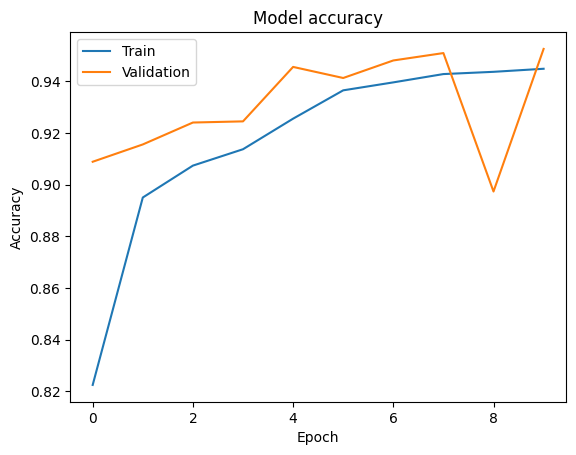

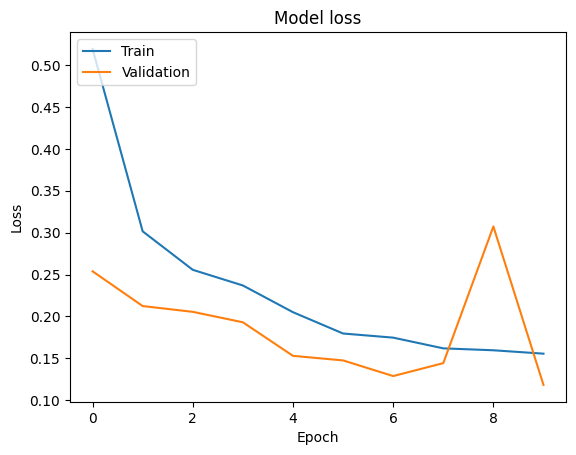

In [ ]:
# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [ ]:
# Evaluate the model

evaluation = model1.evaluate(X_test, y_test)
print(f"Test Accuracy: {evaluation[1]}")

438/438 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9052 - loss: 0.2694
Test Accuracy: 0.9031428694725037


In [ ]:
y_pred = model1.predict(X_test)

438/438 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


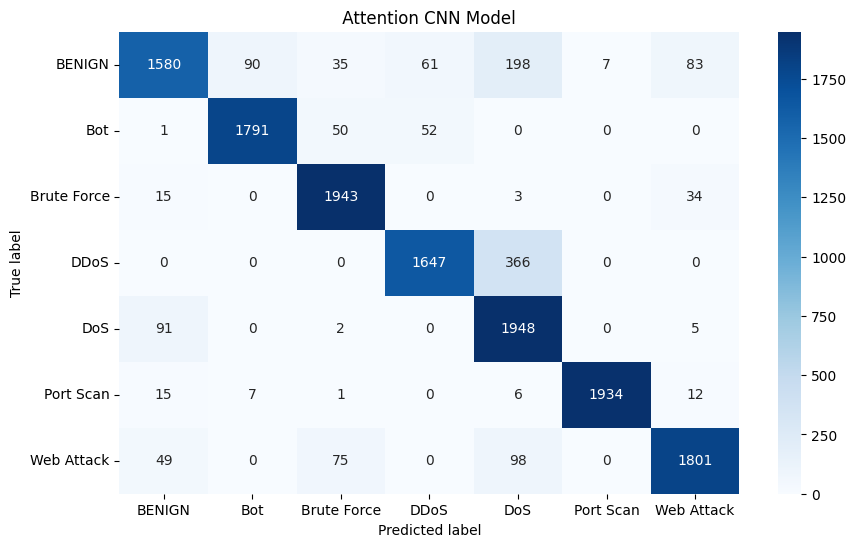

In [ ]:
# Convert the predicted probabilities to class labels
y_pred_classes = np.argmax(y_pred, axis=1)

# Now use y_pred_classes in the confusion_matrix function
conf_matrix_model1 = confusion_matrix(np.argmax(y_test, axis=1), y_pred_classes)

plt.figure(figsize =(10,6))
sns.heatmap(conf_matrix_model1, annot = True, fmt ='d', cmap = 'Blues', xticklabels = labels, yticklabels = labels)
plt.title(' Attention CNN Model ')

plt.xlabel('Predicted label')
plt.ylabel('True label')

plt.show()

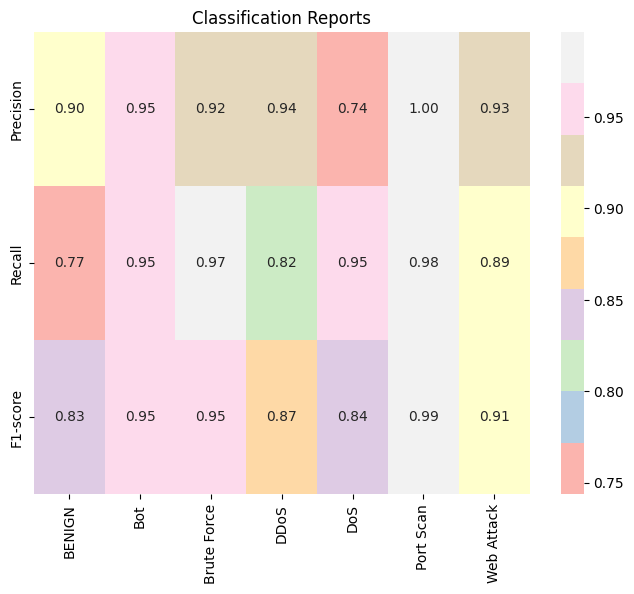

In [ ]:
y_test_classes = np.argmax(y_test, axis=1)
metrics1 = classification_report(y_true = y_test_classes, y_pred = y_pred_classes, target_names = labels, output_dict = True)
precision1 = [metrics1[target_name]['precision'] for target_name in labels]
recall1 = [metrics1[target_name]['recall'] for target_name in labels]
f1_score1 = [metrics1[target_name]['f1-score'] for target_name in labels]
data1 = np.array([precision1, recall1, f1_score1])
rows = ['Precision', 'Recall', 'F1-score']
plt.figure(figsize= (8,6))

sns.heatmap(data1, cmap = 'Pastel1', annot = True, fmt = '.2f', xticklabels = labels, yticklabels = rows)
plt.title('Classification Reports')
plt.show()

In [ ]:
print(f' Accuracy score, {accuracy_score(y_pred_classes, y_test_classes)}')

 Accuracy score, 0.9031428571428571


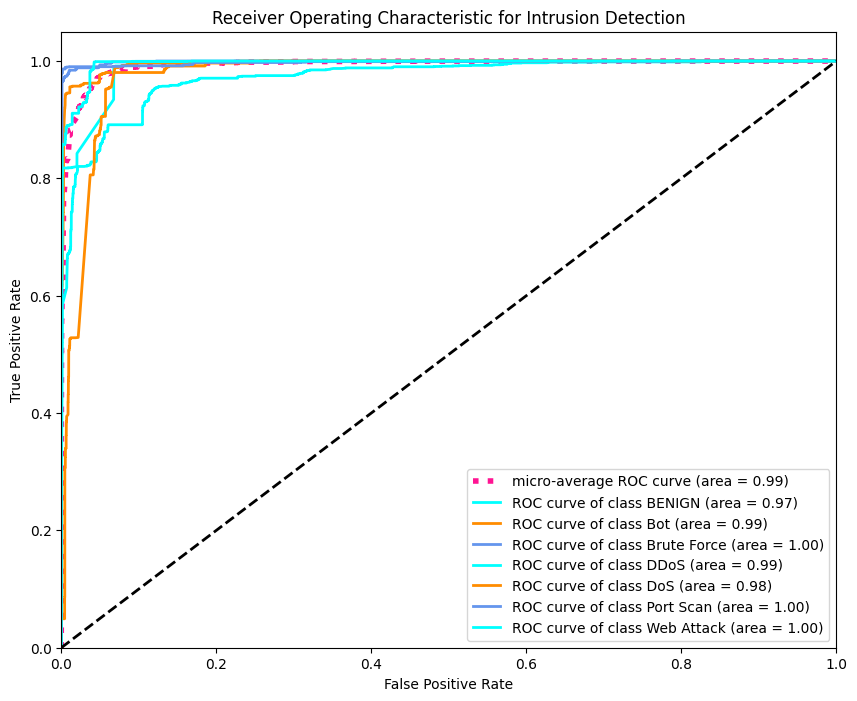

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle

num_classes = len(labels)
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot ROC curves
plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])
for i, color in zip(range(num_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(labels[i], roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic for Intrusion Detection')
plt.legend(loc="lower right")
plt.show()


get attention map

In [ ]:
def get_attention_maps(model, data, layer_name):
    """
    Extract attention maps for a given CBAM layer.
    """
    intermediate_layer_model = tf.keras.Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
    attention_maps = intermediate_layer_model(data, return_attention=True)
    return attention_maps


In [ ]:
import shap

# Define a prediction function
def predict_fn(data):
    return model.predict(data)

# Initialize SHAP explainer (use GradientExplainer for TensorFlow models)
explainer = shap.GradientExplainer(model, new_train[:1000])  # Use a subset of training data for initialization

# Calculate SHAP values for a test instance
shap_values = explainer.shap_values(new_test[:1000])




In [ ]:
# Assuming shap_values has shape (14000, 71, 1, 7)
shap_values_reshaped = shap_values.squeeze(axis=2)  # Remove the last dimension, now shape: (14000, 71, 7)


In [ ]:
shap_values_reshaped.shape

(1000, 71, 7)

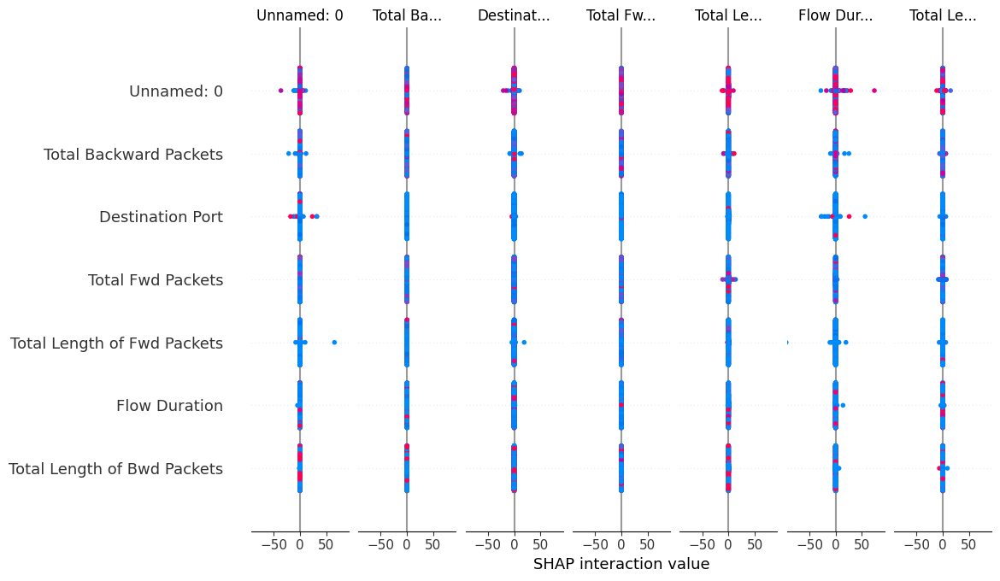

In [ ]:
# Visualize the explanation
shap.summary_plot(shap_values_reshaped, X_test[:1000])

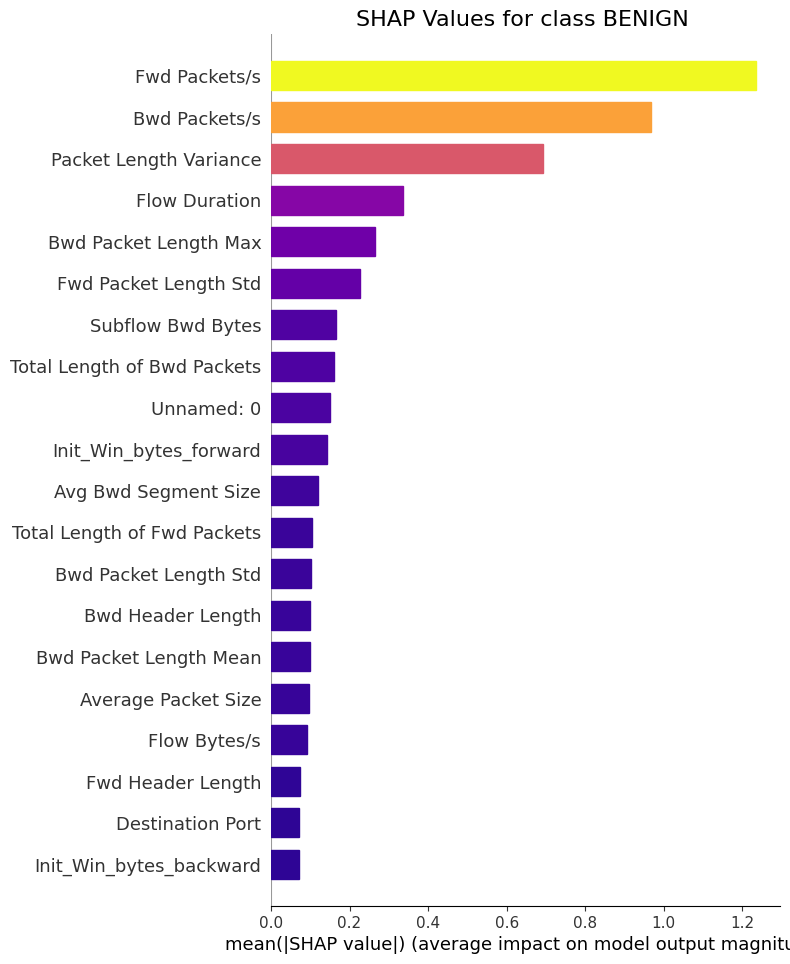

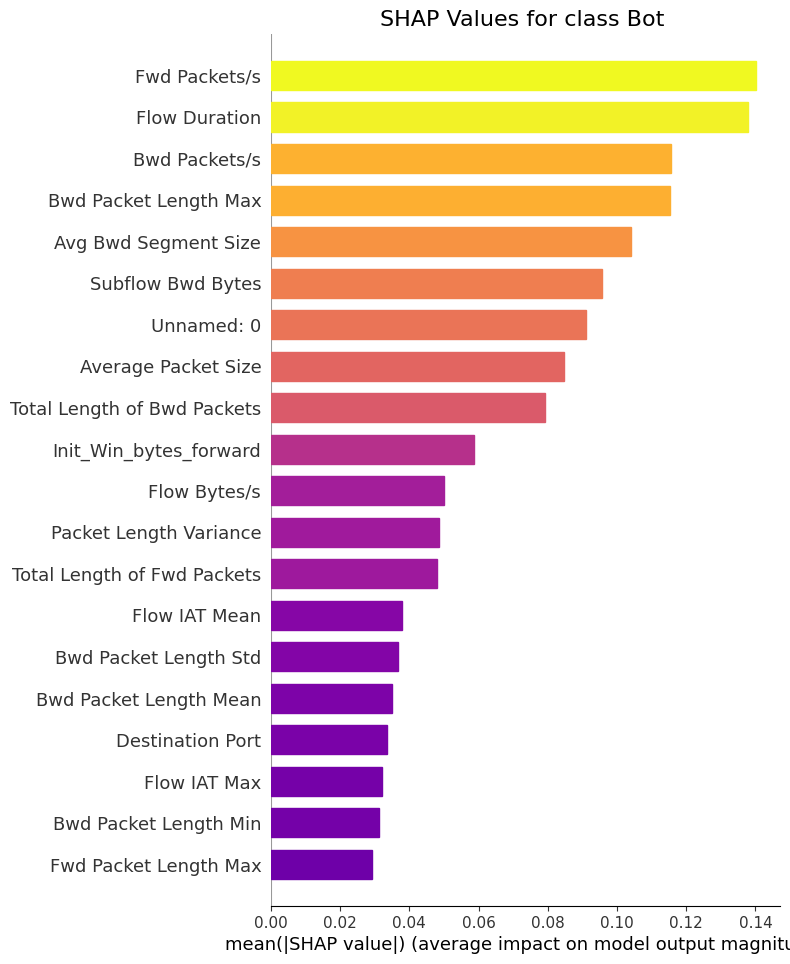

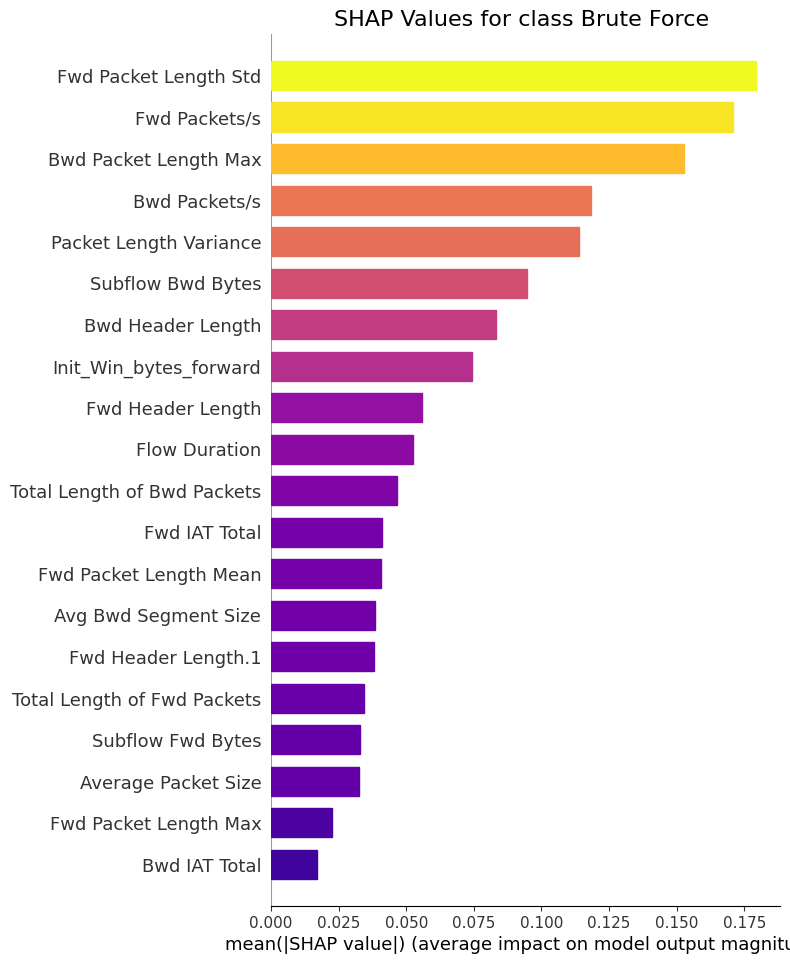

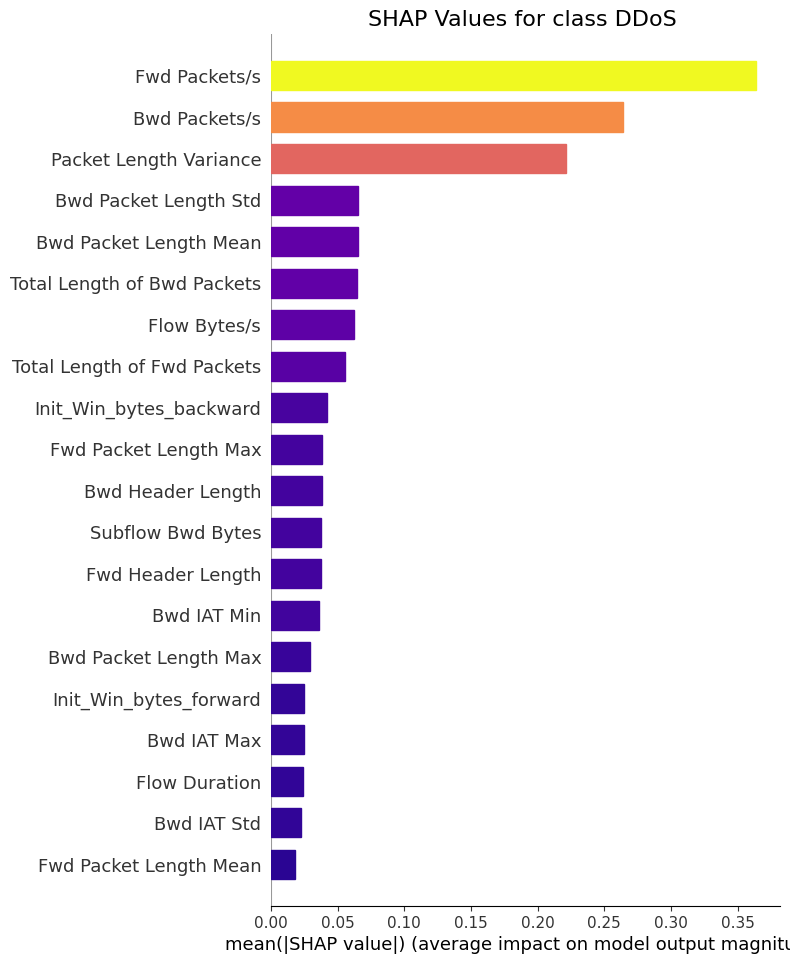

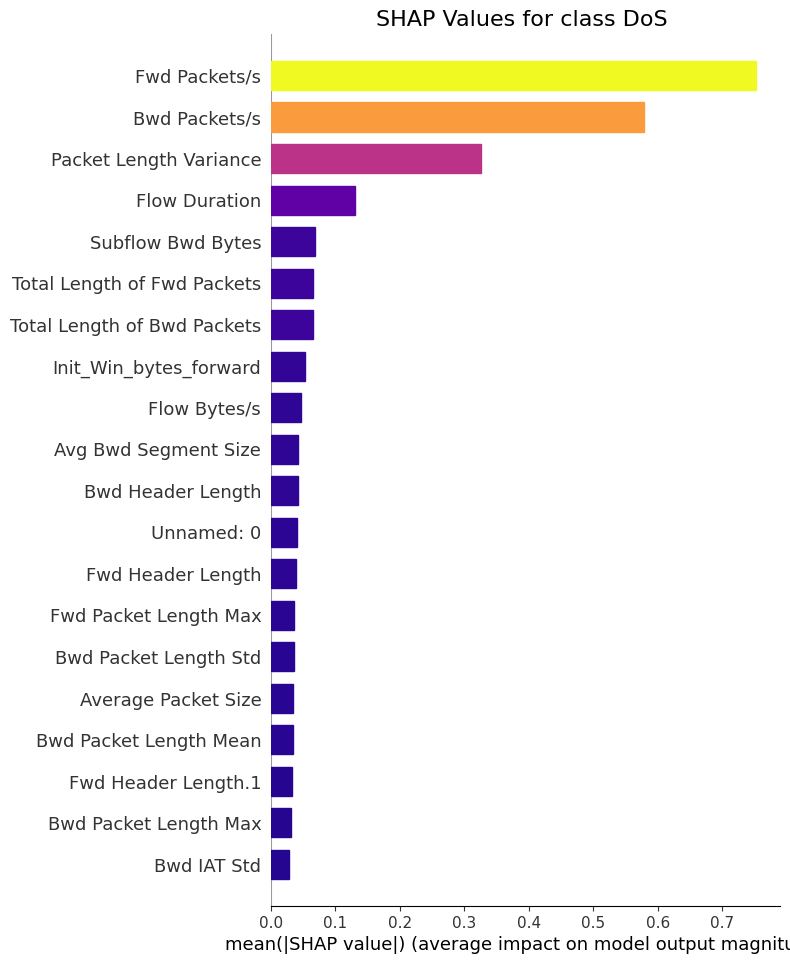

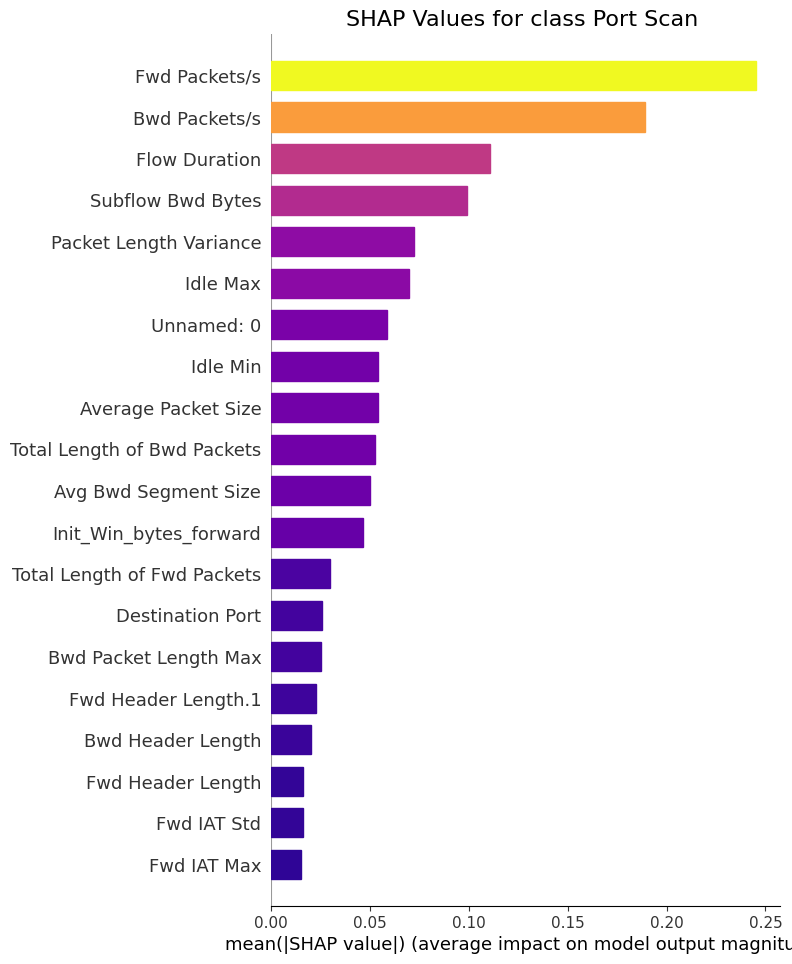

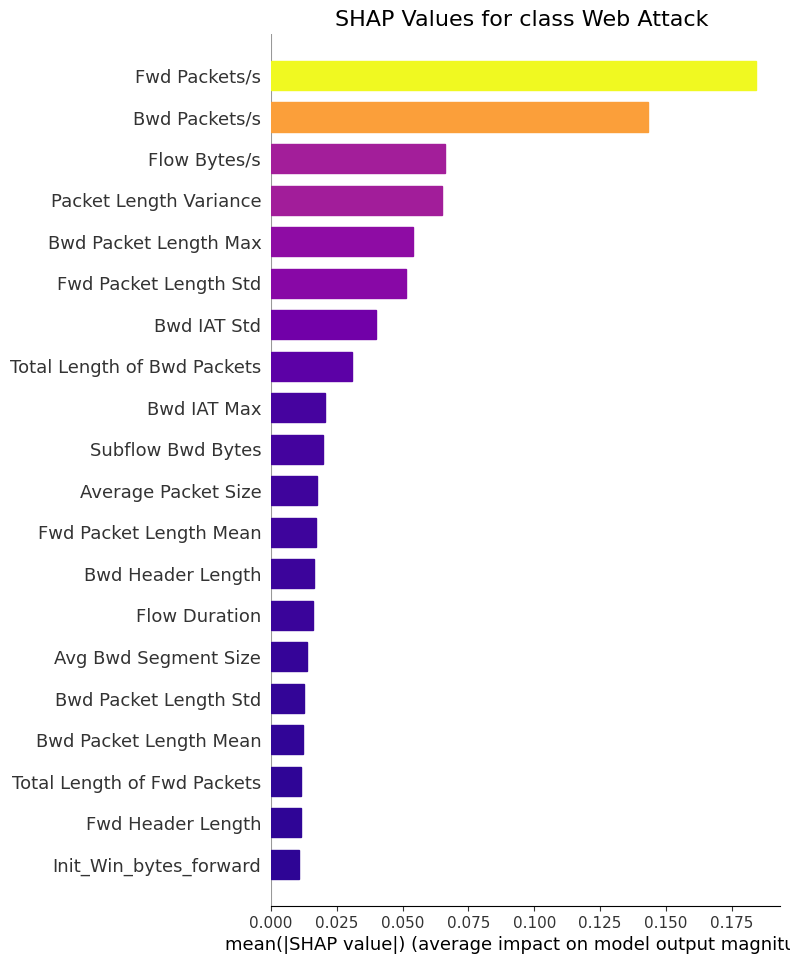

In [ ]:
import matplotlib.cm as cm

# Choose a colormap
cmap = cm.get_cmap("plasma")  # Try 'plasma', 'coolwarm', etc.
for i in range(7):
    # Generate the summary plot
    plt.figure(figsize=(10, 6))
    shap.summary_plot(
        shap_values_reshaped[:, :, i], X_test, plot_type="bar", show=False  # Generate without showing
    )

    # Apply a gradient based on feature importance
    bars = plt.gca().patches
    importance_values = [bar.get_width() for bar in bars]
    colors = cmap(importance_values / max(importance_values))  # Normalize to colormap range

    for bar, color in zip(bars, colors):
        bar.set_color(color)

    plt.title(f"SHAP Values for class {labels[i]} ", fontsize=16)
    plt.show()

In [ ]:


import tensorflow as tf

def get_attention_maps(model, instance, attention_layer_name):
    # Get intermediate model that outputs the attention maps
    intermediate_model = tf.keras.models.Model(inputs=model.input,
                                               outputs=model.get_layer(attention_layer_name).output)

    # Get the attention maps for the instance
    attention_maps = intermediate_model.predict(instance)

    # Check shape of the attention maps
    print(attention_maps.shape)

    return attention_maps

# Get attention maps for a single instance
instance = X_test[:1]  # Select a test instance (shape should be (1, 71, 1))

# Extract attention maps
attention_maps = get_attention_maps(model1, instance, "cbam1d_11")  # Make sure the layer name is correct


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step
(1, 35, 64)


In [ ]:
import tensorflow as tf
import shap
import numpy as np
import matplotlib.pyplot as plt

# Function to get the attention maps
def get_attention_maps(model, instance, attention_layer_name):
    intermediate_model = tf.keras.models.Model(inputs=model.input,
                                               outputs=model.get_layer(attention_layer_name).output)
    attention_maps = intermediate_model.predict(instance)
    print("Shape of Attention Maps:", attention_maps.shape)
    return attention_maps

# Extract attention maps for a specific instance
instance = X_test[:1]  # Select the first test instance (shape (1, 71, 1))

# Get attention maps from the specified layer (e.g., "cbam1d_11")
attention_maps = get_attention_maps(model1, instance, "cbam1d_11")  # Adjust the layer name accordingly

# Assume shap_values is already computed for the instance and has shape (14000, 35, 64)
# Extract SHAP values for the specific instance (e.g., for the first instance)
shap_values_instance = shap_values_reshaped[0, :, :]  # Extract SHAP values for the first instance (shape: (35, 64))

# Reshape SHAP values to match the attention map's shape (1, 35, 64)
shap_values_instance_reshaped = shap_values_instance[np.newaxis, :, :]  # Shape: (1, 35, 64)

# Assuming channel_attention has shape (1, 35, 64)
channel_attention_squeezed = attention_maps  # This is the output from the `get_attention_maps()` function

# Combine the attention map with the SHAP values by element-wise multiplication
combined_attention_shap = channel_attention_squeezed * shap_values_instance_reshaped

# Visualize the results
plt.figure(figsize=(12, 6))

# Plot Attention-Weighted SHAP Values for Channel 0 (Index 0)
plt.subplot(1, 3, 1)
plt.imshow(combined_attention_shap[0, :, 0], cmap='viridis', aspect='auto')
plt.colorbar()
plt.title("Attention-Weighted SHAP (Channel 0)")

# Plot Channel Attention for Channel 0 (Index 0)
plt.subplot(1, 3, 2)
plt.imshow(channel_attention_squeezed[0, :, 0], cmap='viridis', aspect='auto')
plt.colorbar()
plt.title("Channel Attention (Channel 0)")

# Plot SHAP Values for Channel 0 (Index 0)
plt.subplot(1, 3, 3)
plt.imshow(shap_values_instance_reshaped[0, :, 0], cmap='viridis', aspect='auto')
plt.colorbar()
plt.title("SHAP Values (Channel 0)")

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 839ms/step
Shape of Attention Maps: (1, 35, 64)


ValueError: operands could not be broadcast together with shapes (1,35,64) (1,71,7) 

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# # Get attention maps for a single instance
# instance = new_test[:1]  # Select a test instance
# channel_attention, spatial_attention = get_attention_maps(model1, instance, "cbam1d_11")

# Overlay attention maps with SHAP values
shap_values_instance = shap_values[0][0]  # SHAP values for the selected instance
combined_attention_shap = channel_attention.numpy() * shap_values_instance

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(combined_attention_shap[0], label='Attention-Weighted SHAP')
plt.plot(channel_attention[0], label='Channel Attention', linestyle='--')
plt.plot(shap_values_instance, label='SHAP Values', linestyle=':')
plt.legend()
plt.title("Hybrid Interpretability: Attention and SHAP")
plt.show()


InvalidArgumentError: {{function_node __wrapped__StridedSlice_device_/job:localhost/replica:0/task:0/device:GPU:0}} slice index 1 of dimension 0 out of bounds. [Op:StridedSlice] name: strided_slice/